<a href="https://colab.research.google.com/github/rijuCr7/NLP/blob/master/Assignment_3_Swarnadeep.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
# Question 3
import os
import pickle
import random
from nltk.tokenize import word_tokenize
import string
import gensim
from gensim.models.phrases import Phrases, Phraser
from gensim.models import Word2Vec
import torch
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import re
from urllib import request
import nltk
nltk.download('all')
  

[nltk_data] Downloading collection 'all'
[nltk_data]    | 
[nltk_data]    | Downloading package abc to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/abc.zip.
[nltk_data]    | Downloading package alpino to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/alpino.zip.
[nltk_data]    | Downloading package biocreative_ppi to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping corpora/biocreative_ppi.zip.
[nltk_data]    | Downloading package brown to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/brown.zip.
[nltk_data]    | Downloading package brown_tei to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/brown_tei.zip.
[nltk_data]    | Downloading package cess_cat to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/cess_cat.zip.
[nltk_data]    | Downloading package cess_esp to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/cess_esp.zip.
[nltk_data]    | Downloading package chat80 to /root/nltk_data...
[nltk_data]    |   Unzipp

True

**Question 3**

In [0]:
url_path="https://www.cmi.ac.in/~koustav/Assignment-1/"

In [0]:
def get_files(dir_path):
    files = []
    for file in os.listdir(dir_path):
        files.append(file)
    return files

In [0]:
vocab={}#contains the vocabulary i.e the unique words in the corpus
contents={}
embeddings={}
corpus=[]

In [0]:
def isImpure(word):
    flag = False
    for index in range(len(word)):
        if word[0] in string.punctuation:
            flag=True
        if word[index].isdigit():
            flag = True
    return flag

In [0]:
def process_text(text):
    term_list = word_tokenize(text)
    #print(term_list)
    new_term = ""
    change_terms = {}
    problem = []
    pos = 0
    for term in term_list:
        if term[0].isdigit():
            #print(term)
            problem.append(term)
    for word in problem:
        for i in range(0,len(word)):
            #print(word[i])
            if not word[i].isdigit():
                pos = i
                #print(pos)
                break
        #print(word[:pos])
        #print(word[pos:])
        new_term = word[:pos] + " " + word[pos:]
        change_terms[word] = new_term
        #print(new_term)
    #print(change_terms)
    
    #new_text = ""
    new_text=[]
    for term in term_list:
        if term in change_terms.keys():
            #new_text = new_text + " " + change_terms[term]
            if not isImpure(change_terms[term]):
                new_text.append(change_terms[term])
                vocab[change_terms[term]] = change_terms[term]
        else:
            #new_text = new_text + " " + term
            if not isImpure(term):
                new_text.append(term)
                vocab[term] = term
    return new_text

In [0]:
def read_and_process():
    for i in range(0,271):
        file = 'file'+str(i)+'.txt'
        url=url_path+file
        res=request.urlopen(url)
        file_content=res.read()
        text=file_content.decode('utf-8')
        contents[file] = process_text(text)
        """
        files=get_files(dir_path)
        for file in files:
        file_path = dir_path + "/" + file
        #processing each file seperately
        fp = open(file_path,"r")
        file_content = fp.read()
        contents[file] = process_text(file_content)"""

In [0]:
read_and_process()

In [0]:
def create_corpus_to_pass():
    read_and_process()
    for values in contents.values():
        corpus.append(values)

In [0]:
create_corpus_to_pass()

In [13]:
corpus

[['An',
  'airplane',
  'accelerates',
  'down',
  'a',
  'runway',
  'at',
  'for',
  's',
  'until',
  'is',
  'finally',
  'lifts',
  'off',
  'the',
  'ground',
  'Determine',
  'the',
  'distance',
  'traveled',
  'before',
  'takeoff'],
 ['A',
  'car',
  'starts',
  'from',
  'rest',
  'and',
  'accelerates',
  'uniformly',
  'over',
  'a',
  'time',
  'of',
  'seconds',
  'for',
  'a',
  'distance',
  'of',
  'm.',
  'Determine',
  'the',
  'acceleration',
  'of',
  'the',
  'car'],
 ['Upton',
  'Chuck',
  'is',
  'riding',
  'the',
  'Giant',
  'Drop',
  'at',
  'Great',
  'America',
  'If',
  'Upton',
  'free',
  'falls',
  'for',
  'seconds',
  'what',
  'will',
  'be',
  'his',
  'final',
  'velocity',
  'and',
  'how',
  'far',
  'will',
  'he',
  'fall'],
 ['A',
  'race',
  'car',
  'accelerates',
  'uniformly',
  'from',
  'm/s',
  'to',
  'm/s',
  'in',
  'seconds',
  'Determine',
  'the',
  'acceleration',
  'of',
  'the',
  'car',
  'and',
  'the',
  'distance',
  'tra

In [0]:
w2v_model = Word2Vec(min_count=1,
                     window=2,
                     size=150,
                     sample=6e-5, 
                     alpha=0.03, 
                     min_alpha=0.0007, 
                     negative=20,
                     workers=10)

In [0]:
w2v_model.build_vocab(corpus, progress_per=10000)

In [16]:
w2v_model.train(corpus, total_examples=w2v_model.corpus_count, epochs=30, report_delay=1)

(60792, 267840)

In [17]:
print(len(w2v_model.wv['actually']))

150


In [0]:
#creating the embeddings dictionary
for sentence in corpus:
    for word in sentence:
        embeddings[word]=w2v_model.wv[word]

In [0]:
class_1 = [0,1,1,0,1,0,0,0]
class_2 = [1,0,0,1,1,0,1,0]
class_3 = [1,1,0,0,1,0,1,0]
class_4 = [1,0,1,0,0,0,1,0]

In [0]:
index={}

In [29]:
def isQuestion(sentence):
    flag = False
    question_terms = ["calculate","what","why","when","how","find","determine"]
    if sentence.endswith("?"):
        return True
    else:
        terms = word_tokenize(sentence)
        for term in terms:
            if term.lower() in question_terms:
                flag = True
    return flag
#copied from github,match multiple regular expressions
def replace(expr, substitutions):
    substrings = sorted(substitutions, key=len, reverse=True)
    regex = re.compile('|'.join(map(re.escape, substrings)))
    return regex.sub(lambda match: substitutions[match.group(0)], expr)

def standardizeSpeed(text):
    """convert the units to the standard form as prescribed"""
    substitutions={"metres per second":"l/t",
                   "metres per hour":"l/t",
                   "metres per minute":"l/t",
                   "kilometres per second":"l/t",
                   "kilometres per hour":"l/t",
                   "miles per second":"l/t",
                   "miles per hour":"l/t",
                   "miles per minute":"l/t",
                   "konts":"l/t",
                   "feet per second":"l/t",
                   }
    #check for short forms first
    short_form = {"km/hr":"l/t",
                  "km/h":"l/t",
                  "m/s":"l/t",
                  "mi/h":"l/t",
                  "kmh":"l/t"
                  }
    term_list = word_tokenize(text)
    output_length = ""
    for word in term_list:
        if word.lower() in short_form.keys():
            output_length = output_length + " " + short_form[word.lower()]
        else:
            output_length = output_length + " " + word
    #output_length = replace(text,substitutions)
    return output_length
# In[05]
def standardizeTime(text):  
    #convert the time to the standard form
    substitutions={"seconds":"t",
                   "minutes":"t",
                   "hours":"t",
                   "second":"t",
                   "minute":"t",
                   "hour":"t",
                   "s":"t"
                   }
    term_list = word_tokenize(text)
    output_length = ""
    for word in term_list:
        if word.lower() in substitutions.keys():
            output_length = output_length + " " + substitutions[word.lower()]
        else:
            output_length = output_length + " " + word
    #output_length = replace(text,substitutions)
    return output_length
# In[06]
def standardizeLength(text):
    substitutions={"metres":"l",
                   "miles":"l",
                   "degree":"l",
                   "meters":"l",
                   "miles":"l",
                   "kilometres":"l",
                   "centimetres":"l",
                   "ms":"l",
                   "mi":"l",
                   "m":"l",
                   "cms":"l",
                   "kms":"l",
                   "m":"l",
                   "cm":"l",
                   "km":"l",
                   str(chr(176)):"l" #degree symbol
                   }
    term_list = word_tokenize(text)
    output_length = ""
    for word in term_list:
        for punct in string.punctuation:
            if punct != '/':
                word = word.replace(punct,"")
        if word.lower() in substitutions.keys():
            output_length = output_length + " " + substitutions[word.lower()]
        else:
            output_length = output_length + " " + word
    return output_length
# In[07]
def standardizeAcc(text):
    substitutions={"m/s2":" l/t2",
                   "m/s^2":" l/t2"
                   }
    output_length = replace(text,substitutions)
    return output_length
# In[08]
def splitNumbersAndUnits(text):
    term_list = word_tokenize(text)
    #print(term_list)
    new_term = ""
    change_terms = {}
    problem = []
    pos = 0
    for term in term_list:
        if term[0].isdigit():
            #print(term)
            problem.append(term)
    for word in problem:
        for i in range(0,len(word)):
            #print(word[i])
            if not word[i].isdigit():
                pos = i
                #print(pos)
                break
        #print(word[:pos])
        #print(word[pos:])
        new_term = word[:pos] + " " + word[pos:]
        change_terms[word] = new_term
        #print(new_term)
    #print(change_terms)
    new_text = ""
    for term in term_list:
        if term in change_terms.keys():
            new_text = new_text + " " + change_terms[term]
        else:
            new_text = new_text + " " + term
    return new_text
# In[09]
def standardizeText(text):
    #insert accleration standardize here
    accleration = standardizeAcc(text)
    speed = standardizeSpeed(accleration)
    time_speed = standardizeTime(speed)
    length_time_speed =  standardizeLength(time_speed)
    final_standard=""
    tokens = word_tokenize(length_time_speed)
    #checking for spurious units
    for i in range(0,len(tokens)):
        #print(length_time_speed[i])
        if i >= 0:
            if tokens[i] == 'l/t':
                if (i-1) >= 0 and not tokens[i-1].isdigit():
                    #length_time_speed[i] = " "
                    final_standard = final_standard + " "
                else:
                    final_standard = final_standard + " " + tokens[i]
            elif tokens[i] == 'l':
                if (i-1) >= 0 and not tokens[i-1].isdigit():
                    #length_time_speed[i] = " "
                    final_standard = final_standard + " "
                else:
                    final_standard = final_standard + " " + tokens[i]
            elif tokens[i] == 't':
                if (i-1) >= 0 and not tokens[i-1].isdigit():
                    #length_time_speed[i] = " "
                    final_standard = final_standard + " "
                else:
                    final_standard = final_standard + " " + tokens[i]
            elif tokens[i] == 'l/t2':
                if (i-1) >= 0 and not tokens[i-1].isdigit():
                    #length_time_speed[i] = " "
                    final_standard = final_standard + " "
                else:
                    final_standard = final_standard + " " + tokens[i]
            else:
                final_standard = final_standard + " " + tokens[i]
    return final_standard
# In[10]
#creating dictionaries for synomyms 
distance = {'distance':"distance",
            'displacement':"displacement",
            'area':"area",
            'height':"height",
            'far':"far",
            'tall':"tall",
            'length':"length",
            'orbit':"orbit",
            'high':"high",
            'angle':"angle",
            'altitude':"altitude",
            'radius':"radius",
            'scope':"scope",
            'seperation':"seperation",
            'size':"size",
            'stretch':"stretch",
            'width':"width",
            'degreee':"degree",
        }
speed = {'velocity':"velocity",
         'agility':"agility",
         'pace':"pace",
         'quickness':"quickness",
         'swiftness':"swiftnes",
         'speed':"speed",
         'fast':"fast"
         }
time = {'time':"time",
        'long':"long",
        'seconds':"seconds",
        'hang time':"hang time",
        'hangtime':"hangtime",
        'hang-time':"hang-time",
        'in the air':"in the air"
        }

accleration = {'acceleration':"acceleration",
               'deceleration':"deceleration"
               }
# In[11]
#this method is always run after the standardizeText method 
def extractInformation(sentence):
    information = {'Speed(V)':0,
                   'Speed(Q)':0,
                   'Distance(V)':0,
                   'Distance(Q)':0,
                   'Time(V)':0,
                   'Time(Q)':0,
                   'Acceleration(V)':0,
                   'Acceleration(Q)':0
                   }
    term_list = word_tokenize(sentence)
    #print(term_list)
    for word in term_list:
        if word == "l/t":
            #print("Speed as Value")
            information['Speed(V)'] = 1
        if word == "l":
            #print("Distance as Value")
            information['Distance(V)'] = 1
        if word == "t":
            #print("Time as Value")
            information['Time(V)'] = 1
        if word == "l/t2":
            #print("Acceleration as Value")
            information['Acceleration(V)'] = 1                
    for i in range(len(term_list)):
        word = term_list[i]
        if word.lower() in speed.values():
            flag = False
            for j in range(i+1,len(term_list)):
                if "l/t" == term_list[j]:
                    flag = True
                    break
            if flag :
                information['Speed(V)'] = 1
                #print("Speed as Value")
            else:
                information['Speed(Q)'] = 1
                #print("Speed as Question")
        if word.lower() in distance.values():
            flag = False
            punctuation = "!#$%&'()*+,-.:;<=>?@[\]^_`{|}~"
            useless = False
            for j in range(i+1,len(term_list)):
                if "l" == term_list[j]:
                    flag = True
                    break
                elif term_list[j] in punctuation:
                    useless = True
            if flag and not useless:
                information['Distance(V)'] = 1
                #print("Distance as Value")
            else:
                if not useless:
                    information['Distance(Q)'] = 1
                    #print("Distance as Question")
        if word.lower() in time.values():
            flag = False
            for j in range(i+1,len(term_list)):
                if "t" == term_list[j]:
                    flag = True
                    break
            if flag :
                information['Time(V)'] = 1
                #print("Time as Value")
            else:
                information['Time(Q)'] = 1
                #print("Time as Question")
        if word.lower() in accleration.values():
            flag = False
            for j in range(i+1,len(term_list)):
                if "l/t2" == term_list[j]:
                    flag = True
                    break
            if flag :
                information['Acceleration(V)'] = 1
                #print("Accleration as Value")
            else:
                information['Acceleration(Q)'] = 1
                #print("Accleration as Question")
    return information
# In[12]
def is_useless(statement):
    term_list = word_tokenize(statement)
    #print(term_list)
    flag = True
    for word in term_list:
        if word == "l/t":
            flag =  False
            break
        if word == "t":
            flag = False
            break
        if word == "l":
            flag = False
            break
        if word == "l/t2":
            flag = False
            break
    return flag
# In[13]
def eliminateBrackets(problem):
    bracketed=problem[problem.find("(")+1:problem.find(")")]#finding string between 2 brackets
    #if useless then eliminate the bracketed part
    print(is_useless(bracketed))
    if is_useless(bracketed):
        temp_new_problem = problem.replace(bracketed," ")
        new_problem = temp_new_problem.replace("( )"," ")
        return new_problem
    else:
        return problem

def list_indexing_terms():
    #results = open("/home/swarnadeep/Documents/Courses/2nd_Sem/NLP/Assignments/write.txt","w")
    #files = get_files(dir_path)
    count = 0
    for i in range(0,271):
        file = 'file'+str(i)+'.txt'
        url=url_path+file
        res=request.urlopen(url)
        file_content=res.read()
        text=file_content.decode('utf-8')
        index[file] = extractInformation(standardizeText(splitNumbersAndUnits(text)))
    """for file in files:
        file_path = dir_path + "/" + file
        #processing each file seperately
        fp = open(file_path,"r")
        file_content = fp.read()
        index[file] = extractInformation(standardizeText(splitNumbersAndUnits(file_content)))
        count = count + 1"""
    print(count)
    print(index)
    
list_indexing_terms()


0
{'file0.txt': {'Speed(V)': 0, 'Speed(Q)': 0, 'Distance(V)': 0, 'Distance(Q)': 1, 'Time(V)': 1, 'Time(Q)': 0, 'Acceleration(V)': 1, 'Acceleration(Q)': 0}, 'file1.txt': {'Speed(V)': 0, 'Speed(Q)': 0, 'Distance(V)': 1, 'Distance(Q)': 0, 'Time(V)': 1, 'Time(Q)': 0, 'Acceleration(V)': 0, 'Acceleration(Q)': 1}, 'file2.txt': {'Speed(V)': 0, 'Speed(Q)': 1, 'Distance(V)': 0, 'Distance(Q)': 1, 'Time(V)': 1, 'Time(Q)': 0, 'Acceleration(V)': 0, 'Acceleration(Q)': 0}, 'file3.txt': {'Speed(V)': 1, 'Speed(Q)': 0, 'Distance(V)': 0, 'Distance(Q)': 1, 'Time(V)': 1, 'Time(Q)': 0, 'Acceleration(V)': 0, 'Acceleration(Q)': 1}, 'file4.txt': {'Speed(V)': 0, 'Speed(Q)': 0, 'Distance(V)': 1, 'Distance(Q)': 0, 'Time(V)': 0, 'Time(Q)': 1, 'Acceleration(V)': 1, 'Acceleration(Q)': 0}, 'file5.txt': {'Speed(V)': 1, 'Speed(Q)': 0, 'Distance(V)': 0, 'Distance(Q)': 1, 'Time(V)': 1, 'Time(Q)': 0, 'Acceleration(V)': 0, 'Acceleration(Q)': 1}, 'file6.txt': {'Speed(V)': 1, 'Speed(Q)': 0, 'Distance(V)': 1, 'Distance(Q)': 0,

In [0]:
# #load the index from the pickle file
# with open('domain-index.pickle', 'rb') as handle:
#     index = pickle.load(handle)

In [0]:
#encode the problems into vectors
problem_vectors = {}
for problem,vecs in index.items():
    temp=[]
    for item in vecs.values():
        temp.append(item)
    problem_vectors[problem] = temp
    temp=[]
#print(problem_vectors)

In [0]:
def similar_vectors(vec1,vec2):
    sim = 0
    for i in range(len(vec1)):
        if vec1[i] == vec2[i]:
            if vec1[i] == 1:
                sim = sim + 1
    return sim

In [0]:
candidate_labels={}

In [0]:
for problem,vecs in problem_vectors.items():
    temp=[]
    sim_1 = similar_vectors(class_1,vecs)
    sim_2 = similar_vectors(class_2,vecs)
    sim_3 = similar_vectors(class_3,vecs)
    sim_4 = similar_vectors(class_4,vecs)
    temp.append(sim_1)
    temp.append(sim_2)
    temp.append(sim_3)
    temp.append(sim_4)
    candidate_labels[problem] = temp
    temp=[]

In [0]:
assigned_labels = {}

In [0]:
#labelling the problems
for name,labels in candidate_labels.items():
    label = labels.index(max(labels))
    if (max(labels) == 0):
        assigned_labels[name] = 0
    else:
        assigned_labels[name] = label + 1        

In [29]:
assigned_labels

{'file0.txt': 2,
 'file1.txt': 1,
 'file10.txt': 1,
 'file100.txt': 2,
 'file101.txt': 2,
 'file102.txt': 2,
 'file103.txt': 1,
 'file104.txt': 1,
 'file105.txt': 2,
 'file106.txt': 1,
 'file107.txt': 1,
 'file108.txt': 2,
 'file109.txt': 1,
 'file11.txt': 4,
 'file110.txt': 1,
 'file111.txt': 1,
 'file112.txt': 1,
 'file113.txt': 2,
 'file114.txt': 2,
 'file115.txt': 2,
 'file116.txt': 2,
 'file117.txt': 1,
 'file118.txt': 1,
 'file119.txt': 1,
 'file12.txt': 2,
 'file120.txt': 2,
 'file121.txt': 1,
 'file122.txt': 2,
 'file123.txt': 4,
 'file124.txt': 1,
 'file125.txt': 1,
 'file126.txt': 1,
 'file127.txt': 3,
 'file128.txt': 1,
 'file129.txt': 2,
 'file13.txt': 1,
 'file130.txt': 3,
 'file131.txt': 1,
 'file132.txt': 1,
 'file133.txt': 1,
 'file134.txt': 2,
 'file135.txt': 1,
 'file136.txt': 1,
 'file137.txt': 1,
 'file138.txt': 2,
 'file139.txt': 2,
 'file14.txt': 4,
 'file140.txt': 2,
 'file141.txt': 2,
 'file142.txt': 4,
 'file143.txt': 4,
 'file144.txt': 4,
 'file145.txt': 2,
 '

In [0]:
#cluster the labelled problems together
data_set={}
data_set[0]=[]
data_set[1]=[]
data_set[2]=[]
data_set[3]=[]
data_set[4]=[]

In [0]:
for file_names,label in assigned_labels.items():
    file_path=url_path+file_names
    #print(file_path)
    res=request.urlopen(file_path)
    #fp = open(file_path,"r")
    file_content = res.read()
    text=file_content.decode('utf-8')
    data_set[label].append(process_text(text))

In [32]:
data_set

{0: [['A',
   'rock',
   'is',
   'dropped',
   'from',
   'the',
   'garage',
   'roof',
   'from',
   'rest',
   'The',
   'roof',
   'is',
   'meter',
   'from',
   'the',
   'ground',
   'Determine',
   'how',
   'long',
   'it',
   'takes',
   'the',
   'rock',
   'to',
   'hit',
   'the',
   'ground'],
  ['A',
   'projectile',
   'leaves',
   'a',
   'gun',
   'at',
   'the',
   'same',
   'instant',
   'that',
   'the',
   'target',
   'is',
   'dropped',
   'from',
   'rest',
   'If',
   'the',
   'projectile',
   'is',
   'initially',
   'aimed',
   'straight',
   'at',
   'the',
   'target',
   'will',
   'it',
   'hit',
   'the',
   'target']],
 1: [['A',
   'car',
   'starts',
   'from',
   'rest',
   'and',
   'accelerates',
   'uniformly',
   'over',
   'a',
   'time',
   'of',
   'seconds',
   'for',
   'a',
   'distance',
   'of',
   'm.',
   'Determine',
   'the',
   'acceleration',
   'of',
   'the',
   'car'],
  ['Upton',
   'Chuck',
   'is',
   'riding',
   'the',
 

In [0]:
def rand_select(dict_to_select):
    target_tag = random.choice(list(dict_to_select))
    random_target = dict_to_select[target_tag]
    rand_sent_loc = random.randint(0,len(random_target)-1)
    random_sent_to_feed = random_target[rand_sent_loc]
    return (target_tag,random_sent_to_feed)

In [0]:
def lineToTensor(line):
    terms = word_tokenize(line)
    tensor = torch.zeros(len(terms), 1, 150)
    i=0
    for term in terms:
        tensor[i][0] = torch.FloatTensor(embeddings[term])
        i = i + 1
    return tensor

In [0]:
import torch.nn as nn

class RNN(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(RNN, self).__init__()

        self.hidden_size = hidden_size

        self.i2h = nn.Linear(input_size + hidden_size, hidden_size)
        self.i2o = nn.Linear(input_size + hidden_size, output_size)
        self.softmax = nn.LogSoftmax(dim=1)

    def forward(self, input, hidden):
        combined = torch.cat((input, hidden), 1)
        hidden = self.i2h(combined)
        output = self.i2o(combined)
        output = self.softmax(output)
        return output, hidden

    def initHidden(self):
        return torch.zeros(1, self.hidden_size)

n_hidden     =  128
n_dim    = 150 # the size of the dimension
n_categories = 5
rnn = RNN(n_dim, n_hidden, n_categories) 

In [0]:
all_categories = [0,1,2,3,4]

In [0]:
def randomTrainingExample():
    random_pick=rand_select(data_set)
    picked_str=""
    for word in random_pick[1]:
        picked_str = picked_str+" "+word
    category_tensor = torch.tensor([all_categories.index(random_pick[0])], dtype=torch.long)
    #string to pass
    processed = process_text(picked_str)
    to_pass=""
    for term in processed:
        to_pass = to_pass + " " + term
    line_tensor = lineToTensor(to_pass)
    return random_pick[0],random_pick[1], category_tensor, line_tensor


In [0]:
criterion = nn.NLLLoss()

In [0]:
learning_rate = 0.005 # If we set this too high, it might explode. If too low, it might not learn

def train(category_tensor, line_tensor):
    hidden = rnn.initHidden()

    rnn.zero_grad()

    for i in range(line_tensor.size()[0]):
        output, hidden = rnn(line_tensor[i], hidden)

    loss = criterion(output, category_tensor)
    loss.backward()

    # Add parameters' gradients to their values, multiplied by learning rate
    for p in rnn.parameters():
        p.data.add_(-learning_rate, p.grad.data)

    return output, loss.item()

In [0]:
def categoryFromOutput(output):
    top_n, top_i = output.topk(1)
    category_i = top_i[0].item()
    return all_categories[category_i], category_i

In [41]:
import time
import math

n_iters = 10
print_every = 1
plot_every = 1



# Keep track of losses for plotting
current_loss = 0
all_losses = []

def timeSince(since):
    now = time.time()
    s = now - since
    m = math.floor(s / 60)
    s -= m * 60
    return '%dm %ds' % (m, s)

start = time.time()

for iter in range(1, n_iters + 1):
    category, line, category_tensor, line_tensor = randomTrainingExample()
    output, loss = train(category_tensor, line_tensor)
    current_loss += loss

    # Print iter number, loss, name and guess
    #printing the predictions for some of the outputs 
    if iter % print_every == 0:
        guess, guess_i = categoryFromOutput(output)
        correct = '✓' if guess == category else '✗ (%s)' % category
        print('%d %d%% (%s) %.4f %s / %s %s' % (iter, iter / n_iters * 100, timeSince(start), loss, line, guess, correct))

    # Add current loss avg to list of losses
    if iter % plot_every == 0:
        all_losses.append(current_loss / plot_every)
        current_loss = 0


1 10% (0m 0s) 1.6176 ['A', 'meteoroid', 'changed', 'velocity', 'from', 'km/s', 'to', 'km/s', 'in', 'seconds', 'What', 'is', 'the', 'acceleration', 'of', 'the', 'meteoroid'] / 3 ✗ (1)
2 20% (0m 0s) 1.6309 ['A', 'car', 'traveling', 'at', 'm/s', 'skids', 'to', 'a', 'stop', 'in', 's.', 'Determine', 'the', 'skidding', 'distance', 'of', 'the', 'car', 'assume', 'uniform', 'acceleration'] / 3 ✗ (2)
3 30% (0m 0s) 1.5793 ['What', 'is', 'the', 'smallest', 'distance', 'in', 'meters', 'needed', 'for', 'an', 'airplane', 'touching', 'the', 'runway', 'with', 'a', 'velocity', 'of', 'km/h', 'and', 'an', 'acceleration', 'of', 'to', 'come', 'to', 'rest'] / 3 ✗ (2)
4 40% (0m 0s) 1.5130 ['Example', 'A', 'juggler', 'throws', 'a', 'ball', 'straight', 'up', 'with', 'an', 'initial', 'speed', 'of', 'm/s', 'With', 'what', 'speed', 'would', 'she', 'need', 'to', 'throw', 'a', 'second', 'ball', 'half', 'a', 'second', 'later', 'starting', 'from', 'the', 'same', 'position', 'as', 'the', 'first', 'ball', 'so', 'that', 

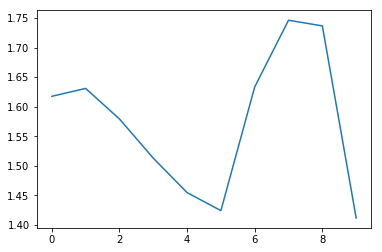

In [42]:
plt.figure()
plt.plot(all_losses)

Question 5:

https://drive.google.com/open?id=1hU9dKFNUnfvoMUkEs9JZ8wL-TUxdHF4G

In [0]:
encoding={}
for i in range(0,271):
        encode=[]
        file = 'file'+str(i)+'.txt'
        url=url_path+file
        res=request.urlopen(url)
        file_content=res.read()
        text=file_content.decode('utf-8')
        text = process_text(text)
        for word in text:
          encode.append(embeddings[word])
        encoding[file] = encode
        
   

**Question 4
Encoding all problem    statements (they are casted to tensors when fed into the RNN)
**

In [26]:
encoding

{'file0.txt': [array([ 0.1603032 ,  0.05710411, -0.15872207, -0.37348333, -0.19067793,
          0.03725852, -0.13800485,  0.0039814 , -0.0358506 , -0.25671393,
          0.02464913,  0.1987517 , -0.13535792, -0.02133624,  0.2081896 ,
          0.19020434,  0.10078166, -0.06550221,  0.04183111,  0.15762253,
          0.04095402,  0.02075987,  0.02123345,  0.09972105,  0.13894103,
         -0.03744493, -0.11807742, -0.02293023, -0.04319406, -0.10872609,
         -0.29872432, -0.03616554,  0.30518684, -0.09624261,  0.15499473,
          0.39964464, -0.12014814,  0.16332935, -0.06251702,  0.28887695,
          0.01848453,  0.18318646,  0.09256405, -0.38124558, -0.14915064,
          0.05698908,  0.27600795, -0.11841161,  0.11699848, -0.04454149,
          0.02555635, -0.13576664, -0.07591195,  0.23656483,  0.09658826,
          0.03751864, -0.38688767, -0.04767219, -0.10164011,  0.08468372,
         -0.01929652,  0.29625773,  0.17401378,  0.04956492,  0.00427053,
         -0.05414247,  0.

**Question 2:
Encoding a problem statement uing one hot encoding,based on the variables supplied and the variables asked**

In [31]:
problem_vectors

{'file0.txt': [0, 0, 0, 1, 1, 0, 1, 0],
 'file1.txt': [0, 0, 1, 0, 1, 0, 0, 1],
 'file10.txt': [0, 1, 1, 0, 0, 1, 0, 0],
 'file100.txt': [0, 0, 0, 1, 1, 0, 0, 0],
 'file101.txt': [0, 0, 0, 1, 1, 0, 0, 0],
 'file102.txt': [0, 0, 0, 1, 1, 0, 0, 0],
 'file103.txt': [0, 0, 1, 0, 0, 1, 0, 0],
 'file104.txt': [0, 0, 1, 0, 0, 1, 0, 0],
 'file105.txt': [0, 0, 0, 1, 0, 1, 0, 0],
 'file106.txt': [0, 0, 1, 0, 0, 1, 0, 0],
 'file107.txt': [0, 0, 1, 0, 0, 1, 0, 0],
 'file108.txt': [0, 0, 0, 1, 0, 1, 0, 0],
 'file109.txt': [0, 1, 0, 0, 1, 0, 0, 0],
 'file11.txt': [1, 0, 1, 0, 0, 0, 0, 1],
 'file110.txt': [0, 1, 0, 0, 1, 0, 0, 0],
 'file111.txt': [0, 1, 0, 0, 1, 0, 0, 0],
 'file112.txt': [0, 1, 0, 0, 1, 0, 0, 0],
 'file113.txt': [0, 0, 0, 1, 1, 0, 0, 0],
 'file114.txt': [0, 0, 0, 1, 1, 0, 0, 0],
 'file115.txt': [0, 0, 0, 1, 1, 0, 0, 0],
 'file116.txt': [0, 0, 0, 1, 1, 0, 0, 0],
 'file117.txt': [0, 0, 1, 0, 0, 0, 0, 0],
 'file118.txt': [0, 0, 1, 0, 0, 1, 0, 0],
 'file119.txt': [0, 1, 1, 0, 0, 0, 0, 0]

**Question 1:
Encode known values
I have outputted all the word embeddings from the corpus which i have calculated using word2vec**

In [32]:
embeddings

{'An': array([ 0.1603032 ,  0.05710411, -0.15872207, -0.37348333, -0.19067793,
         0.03725852, -0.13800485,  0.0039814 , -0.0358506 , -0.25671393,
         0.02464913,  0.1987517 , -0.13535792, -0.02133624,  0.2081896 ,
         0.19020434,  0.10078166, -0.06550221,  0.04183111,  0.15762253,
         0.04095402,  0.02075987,  0.02123345,  0.09972105,  0.13894103,
        -0.03744493, -0.11807742, -0.02293023, -0.04319406, -0.10872609,
        -0.29872432, -0.03616554,  0.30518684, -0.09624261,  0.15499473,
         0.39964464, -0.12014814,  0.16332935, -0.06251702,  0.28887695,
         0.01848453,  0.18318646,  0.09256405, -0.38124558, -0.14915064,
         0.05698908,  0.27600795, -0.11841161,  0.11699848, -0.04454149,
         0.02555635, -0.13576664, -0.07591195,  0.23656483,  0.09658826,
         0.03751864, -0.38688767, -0.04767219, -0.10164011,  0.08468372,
        -0.01929652,  0.29625773,  0.17401378,  0.04956492,  0.00427053,
        -0.05414247,  0.21871778, -0.1325718 